# Fundamentos de OpenCV

Aprenderemos como abrir archivos, verificar pixeles y algunas técnicas de procesamiento de imágenes.

Usaremos las siguientes imágenes de ejemplo, que he tomado prestadas de internet, pero ustedes pueden usar la imagen que deseen.

![John Wick](https://www.indiewire.com/wp-content/uploads/2019/05/07956f40-77c4-11e9-9073-657a85982e73.jpg "John Wick")

![No idea](https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/assets/noidea.jpg "I have no idea")

![Que Paso Ayer](https://www.cinepremiere.com.mx/wp-content/uploads/2009/08/Critica-Que-paso-ayer.jpg "Que paso ayer")

![The Beatles](https://upload.wikimedia.org/wikipedia/commons/b/bd/The_Beatles_with_Jimmie_Nicol_916-5098.jpg)



<p>
 Tiempo estimado: <strong>40 minutos</strong>
</p>



## Realicemos los pasos iniciales

Empezaremos importando las bibliotecas que usaremos: OpenCV, Numpy, y algunas más. Algunas utilerías disponibles en los ejemplos de OpenCv para Python.

In [1]:

# Descargamos las imágenes de prueba y las utilerías
!wget --no-check-certificate \
    https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/assets/noidea.jpg \
    -O noidea.jpg
!wget --no-check-certificate \
    https://www.indiewire.com/wp-content/uploads/2019/05/07956f40-77c4-11e9-9073-657a85982e73.jpg \
    -O johnwick.jpg
!wget --no-check-certificate \
    https://www.cinepremiere.com.mx/wp-content/uploads/2009/08/Critica-Que-paso-ayer.jpg \
    -O quepasoayer.jpg
!wget --no-check-certificate \
    https://fundaciongabo.org/sites/default/files/imagenportada/2019-11/grillo-multicolor-FALSO.jpg \
    -O grillopillo.jpg
!wget --no-check-certificate \
    https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/utils/common.py \
    -O common.py
!wget --no-check-certificate \
    https://upload.wikimedia.org/wikipedia/commons/b/bd/The_Beatles_with_Jimmie_Nicol_916-5098.jpg \
    -O thebeatles.jpg


--2024-06-21 23:19:19--  https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/assets/noidea.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 70503 (69K) [image/jpeg]
Saving to: ‘noidea.jpg’

noidea.jpg          100%[===================>]  68.85K  --.-KB/s    in 0.01s   

2024-06-21 23:19:19 (5.00 MB/s) - ‘noidea.jpg’ saved [70503/70503]

--2024-06-21 23:19:19--  https://www.indiewire.com/wp-content/uploads/2019/05/07956f40-77c4-11e9-9073-657a85982e73.jpg
Resolving www.indiewire.com (www.indiewire.com)... 192.0.66.2
Connecting to www.indiewire.com (www.indiewire.com)|192.0.66.2|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 95157 (93K) [image/jpeg]
Saving to: ‘johnwick.jpg’

johnwick.jpg        100%[=

In [2]:
# Importamos las bibliotecas que utilizaremos
import cv2 #opencv automáticamente se carca como cv2
import common #funciones útiles para openCV
import numpy as np #Biblioteca de manipulación de matrices

#Lo siguiente permite configurar comportamiento del bloc de notas
%matplotlib inline
from matplotlib import pyplot as plt # permite que las imágenes se desplieguen directamente en el bloc de notas
import pylab # Permite controlar el tamaño de las figuras
pylab.rcParams['figure.figsize'] = (10.0, 8.0) # Esto controla el tamaño de las figuras en el bloc de notas

## Abrimos la imagen:

In [28]:
nombre = 'johnwick.jpg'
nombre2 = 'noidea.jpg'
nombre3 = 'quepasoayer.jpg'
nombre4 = 'grillopillo.jpg'
nombre5 = 'thebeatles.jpg'

image=cv2.imread(nombre5)
input_image=cv2.imread(nombre4)
jw = cv2.imread(nombre)

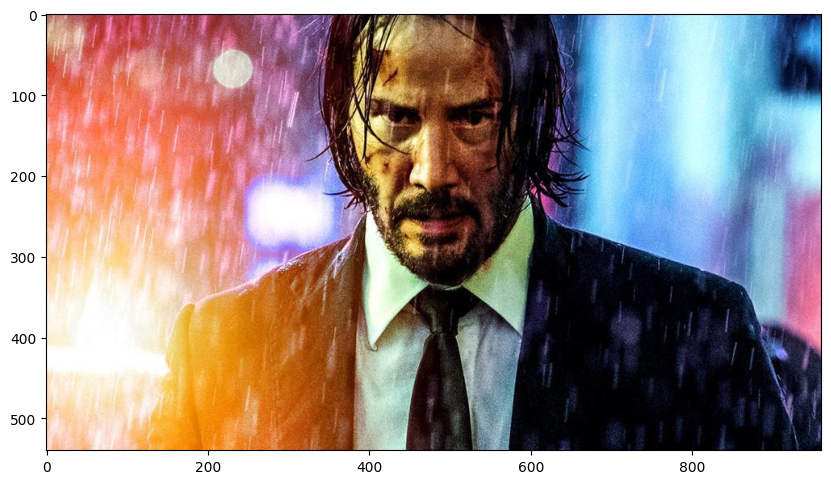

In [30]:
jw_rgb = cv2.cvtColor(jw, cv2.COLOR_BGR2RGB)
plt.imshow(jw_rgb)
jw_rgb_original = jw_rgb.copy()

In [17]:
print(jw_rgb.shape)

(540, 960, 3)


In [23]:
print(jw_rgb[0][0])
print(sum(jw_rgb[0][0])/3)

[187 106 103]
132.0


In [24]:
jw_rgb[0][0] = sum(jw_rgb[0][0])/3

In [25]:
print(jw_rgb[0][0])

[132 132 132]


In [26]:
for i in range(0,540):
  for j in range(0,960):
    jw_rgb[i][j] = sum(jw_rgb[i][j])/3


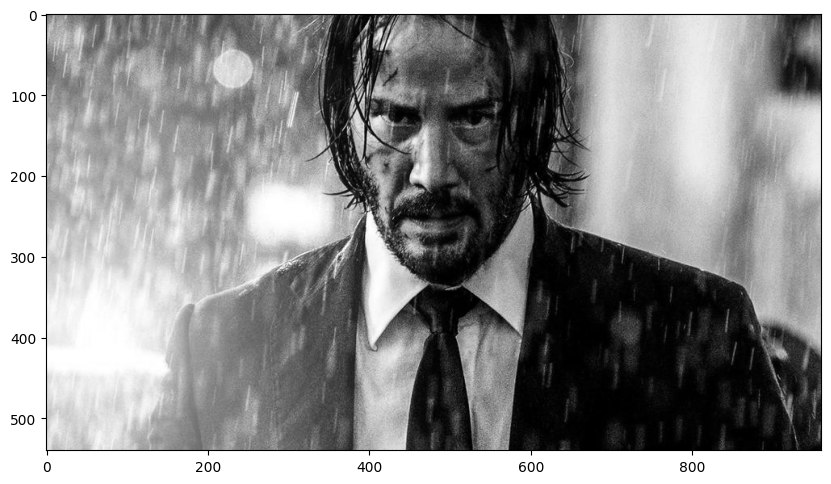

In [27]:
plt.imshow(jw_rgb)

In [37]:
jw2 = jw_rgb_original.copy()

In [35]:
print(jw2[400][400])
jw2[400][400] = 255 - jw2[400][400]
print(jw2[400][400])

[53 41 63]
[202 214 192]


In [38]:
for i in range(0,540):
  for j in range(0,960):
    jw2[i][j] = 255 - jw2[i][j]

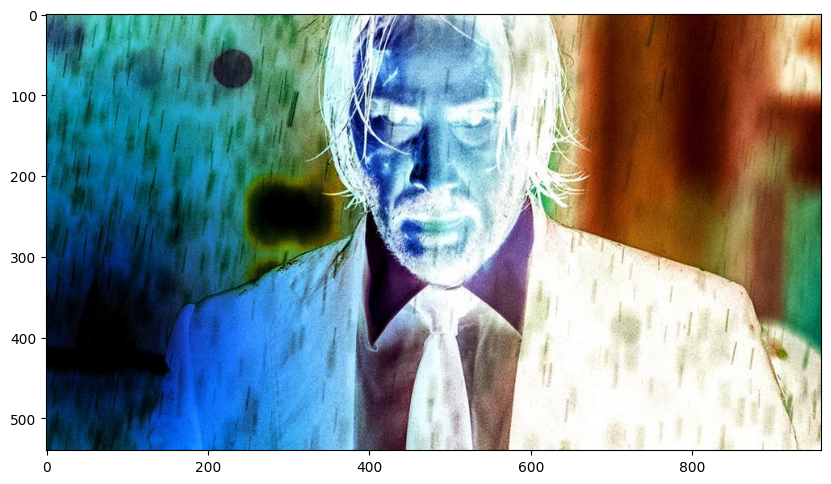

In [39]:
plt.imshow(jw2)

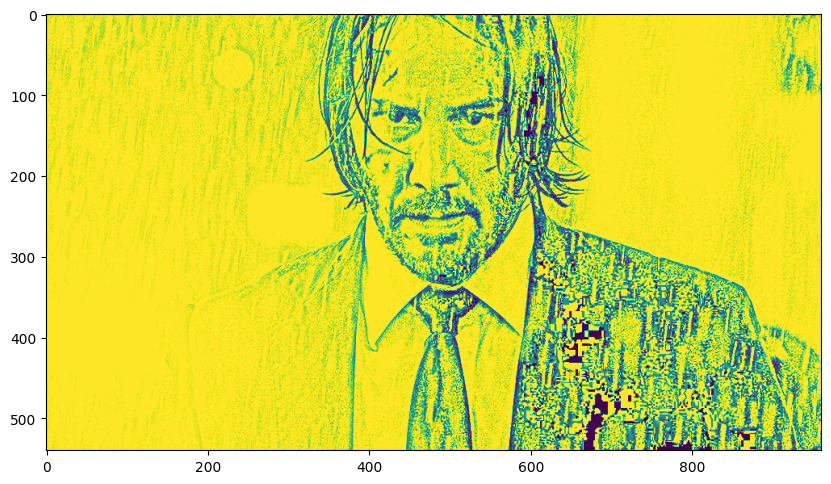

In [12]:
import cv2
gray_image = cv2.cvtColor(jw, cv2.COLOR_BGR2GRAY)
inverted = 255-gray_image
blur = cv2.GaussianBlur(inverted, (21, 21), 0)
invertedblur = 255-blur
sketch = cv2.divide(gray_image, invertedblur, scale=256.0)
cv2.imwrite("sketch.png", sketch)
plt.imshow(sketch)
#cv2.imshow("Image", sketch)

Revisamos algunas características de la imagen

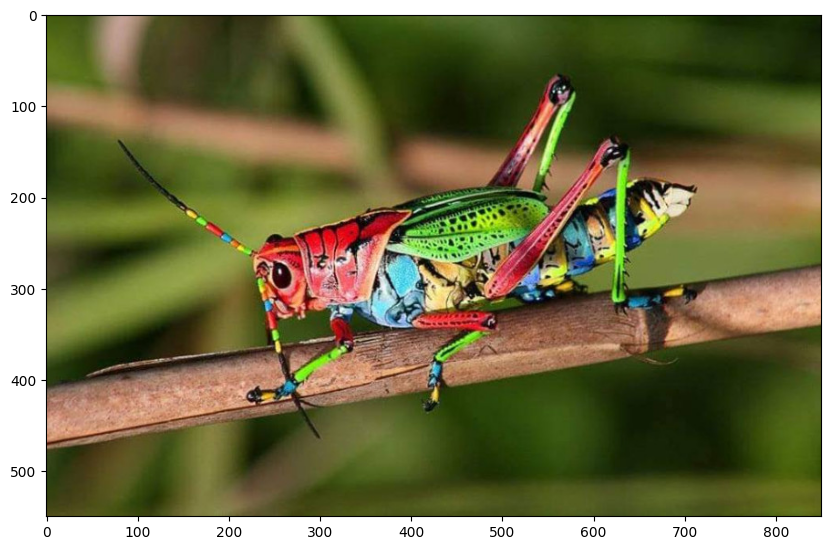

In [43]:
input_image2 = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
plt.imshow(input_image2)

In [40]:
print(input_image.size)

1402500


In [41]:
print(input_image.shape)

(550, 850, 3)


In [44]:
print(input_image.dtype)

uint8


**Nota** Este último dato que nos da el tipo de dato de la imagen es una de las cosas que siempre hay que tomar en cuenta al momento de trabajar con Python, ya que podemos recibir muchos mensajes de error si no trabajamos con los tipos correctos. Lo mismo aplica para los tamaños de las matrices que utilicemos como entradas para funciones o capas de entrada en una red neuronal.

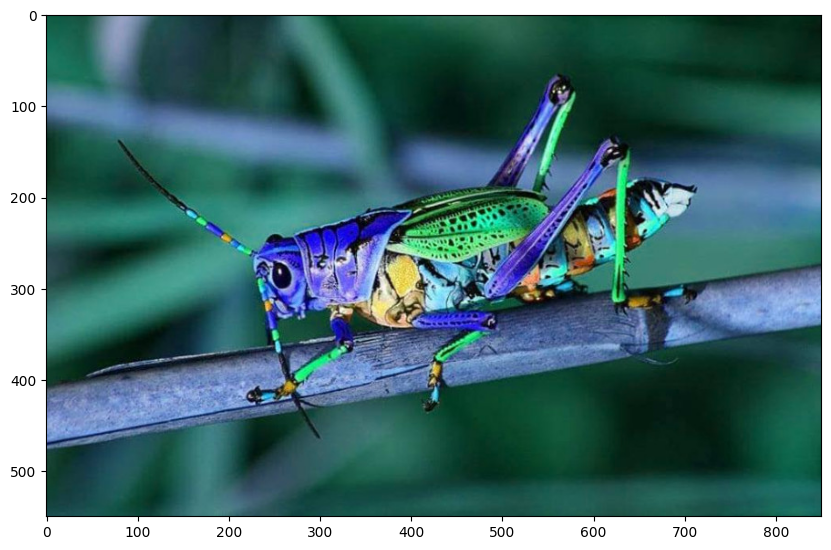

In [45]:
plt.imshow(input_image)

Lo que podemos obervar en esta imagen en comparación a la mostrada previamente es algo clave cuando utilizamos OpenCV: no utiliza el formato RGB para almacenar las imágenes, en su lugar utiliza el formato BGR.

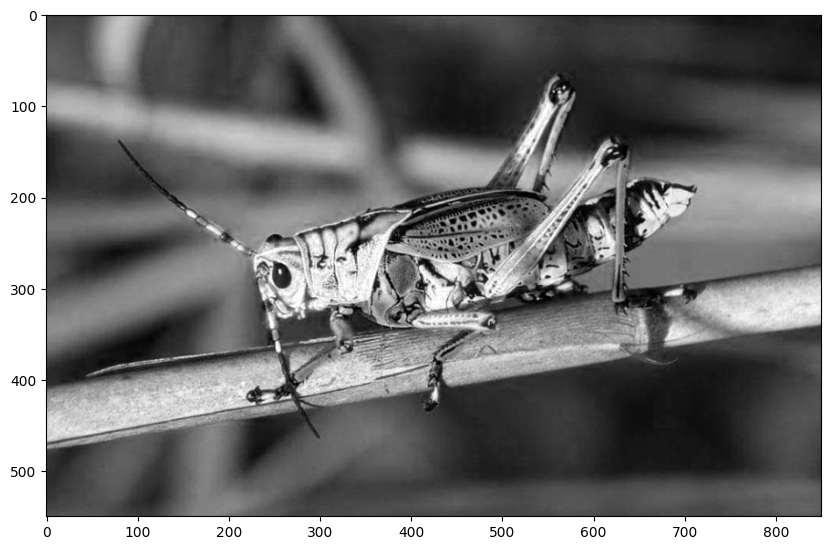

In [51]:
# Separemos los canales de colores
b,g,r=cv2.split(input_image)
# Mostremos uno de los canales
plt.imshow(r, cmap= 'gray')


## conversiones entre espacios de colores, mezclando y separando canales

Podemos convertir entre diversos espacios de colores en OpenCV fácilmente. Arriba vimos como podemos separar canales, veamos ahora un ejemplo de mezclado de canales:

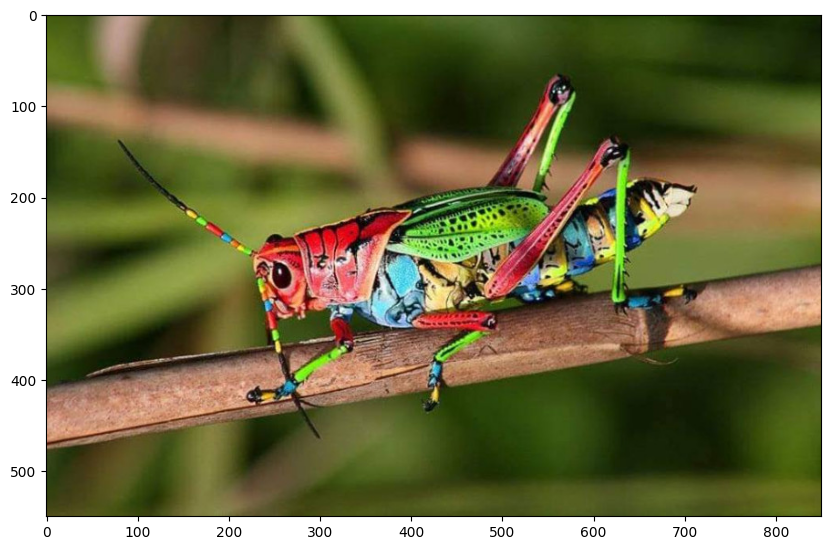

In [52]:
merged=cv2.merge([r,g,b])
# merge takes an array of single channel matrices
plt.imshow(merged)


OpenCV tiene una función específica para trabajar con espacios de colores de las imágenes, por lo que en lugar de separar los canales y volver a mezclarlos a mano, podemos usar esta función.

Existen alredor de 250 banderas de colores en OpenCV para conversión y visualización. Las más comunes son COLOR_BGR2RGB para conversión a RGB, COLOR_BGR2GRAY para conversión a escala de grises y COLOR_BGR2HSV para conversión al espacio de colores: Hue, Saturation, Value. En el siguiente vínculo puedes encontrar más información sobre estas conversiones de colores: [Conversiones](https://docs.opencv.org/master/de/d25/imgproc_color_conversions.html).

In [53]:
# Imprime el número de mapas de colores que maneja OpenCV
COLORflags = [flag for flag in dir(cv2) if flag.startswith('COLOR') ]
print(len(COLORflags))

368


In [54]:
# Imprime los nombres de los mapas de colores
print(COLORflags)

['COLORMAP_AUTUMN', 'COLORMAP_BONE', 'COLORMAP_CIVIDIS', 'COLORMAP_COOL', 'COLORMAP_DEEPGREEN', 'COLORMAP_HOT', 'COLORMAP_HSV', 'COLORMAP_INFERNO', 'COLORMAP_JET', 'COLORMAP_MAGMA', 'COLORMAP_OCEAN', 'COLORMAP_PARULA', 'COLORMAP_PINK', 'COLORMAP_PLASMA', 'COLORMAP_RAINBOW', 'COLORMAP_SPRING', 'COLORMAP_SUMMER', 'COLORMAP_TURBO', 'COLORMAP_TWILIGHT', 'COLORMAP_TWILIGHT_SHIFTED', 'COLORMAP_VIRIDIS', 'COLORMAP_WINTER', 'COLOR_BAYER_BG2BGR', 'COLOR_BAYER_BG2BGRA', 'COLOR_BAYER_BG2BGR_EA', 'COLOR_BAYER_BG2BGR_VNG', 'COLOR_BAYER_BG2GRAY', 'COLOR_BAYER_BG2RGB', 'COLOR_BAYER_BG2RGBA', 'COLOR_BAYER_BG2RGB_EA', 'COLOR_BAYER_BG2RGB_VNG', 'COLOR_BAYER_BGGR2BGR', 'COLOR_BAYER_BGGR2BGRA', 'COLOR_BAYER_BGGR2BGR_EA', 'COLOR_BAYER_BGGR2BGR_VNG', 'COLOR_BAYER_BGGR2GRAY', 'COLOR_BAYER_BGGR2RGB', 'COLOR_BAYER_BGGR2RGBA', 'COLOR_BAYER_BGGR2RGB_EA', 'COLOR_BAYER_BGGR2RGB_VNG', 'COLOR_BAYER_GB2BGR', 'COLOR_BAYER_GB2BGRA', 'COLOR_BAYER_GB2BGR_EA', 'COLOR_BAYER_GB2BGR_VNG', 'COLOR_BAYER_GB2GRAY', 'COLOR_BAYER_

### Cambiemos el espacio de colores de nuestra imagen y visualicémosla de nuevo:

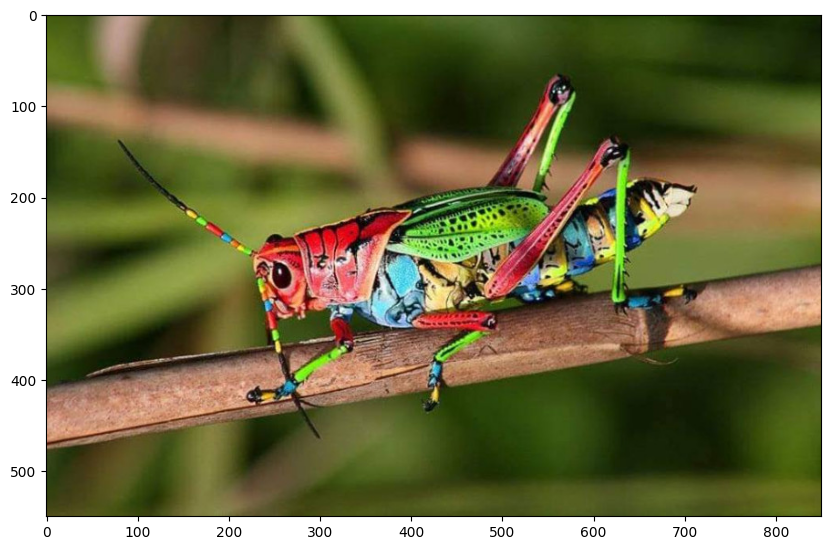

In [55]:
opencv_merged=cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
plt.imshow(opencv_merged)


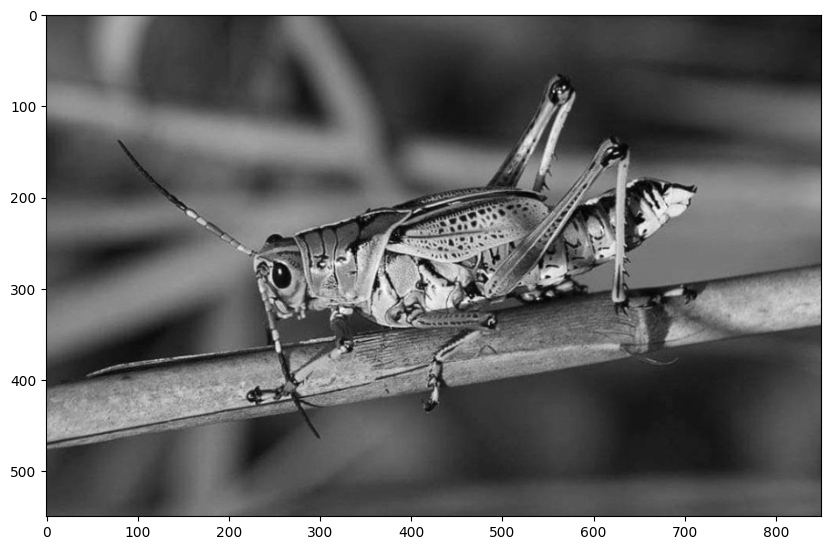

In [56]:
opencv_merged2=cv2.cvtColor(input_image, cv2.COLOR_BGR2GRAY)
plt.imshow(opencv_merged2, cmap='gray')

## Jugando con los espacios de colores

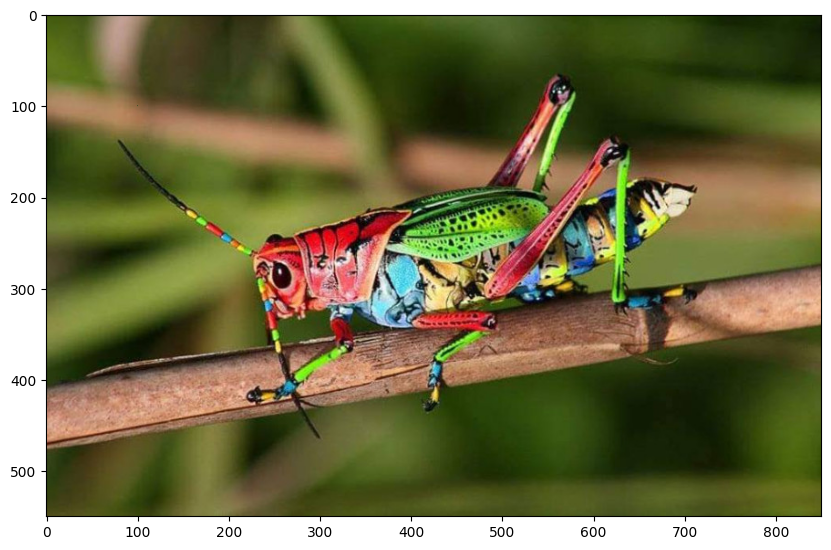

In [78]:
opencv_merged=cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
plt.imshow(opencv_merged)

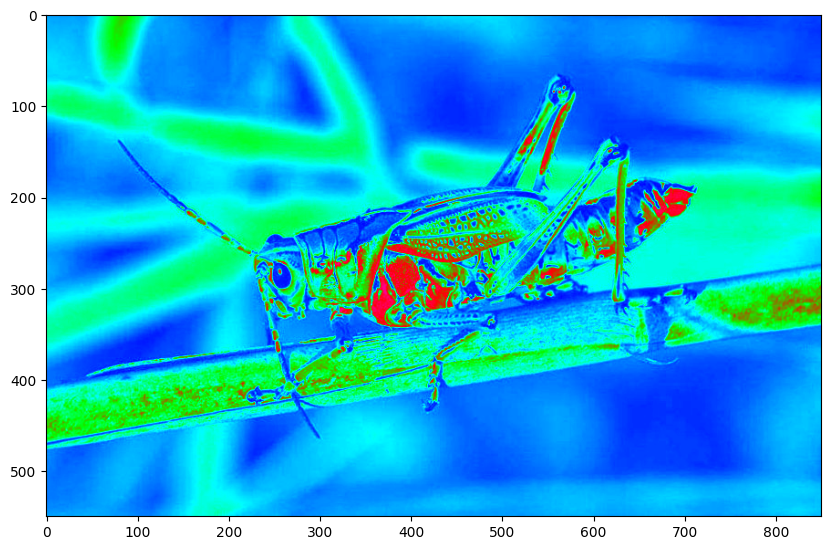

In [66]:
image2 = cv2.applyColorMap(opencv_merged, cv2.COLORMAP_RAINBOW)
#image3 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
plt.imshow(image2)

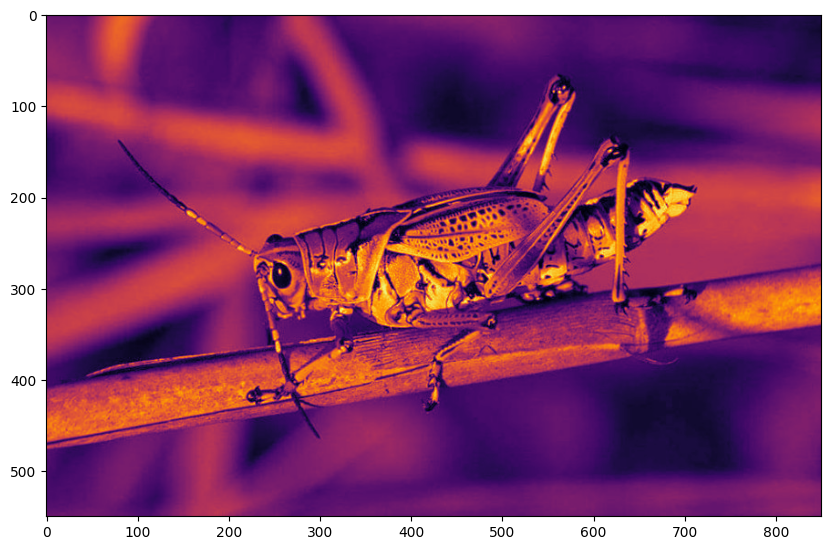

In [70]:
image2 = cv2.applyColorMap(input_image, cv2.COLORMAP_INFERNO)
image3 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
plt.imshow(image3)

In [ ]:
image2 = cv2.applyColorMap(input_image, cv2.COLORMAP_PINK)
image3 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
plt.imshow(image3)

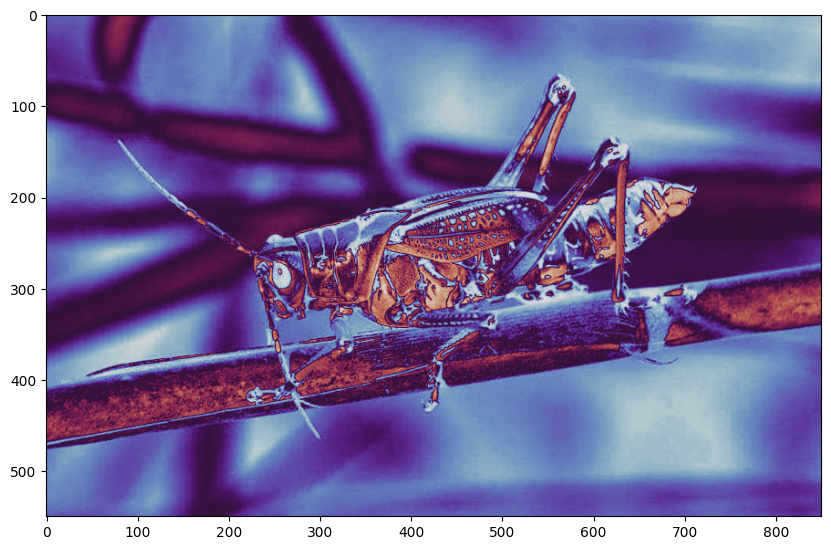

In [71]:
image2 = cv2.applyColorMap(input_image, cv2.COLORMAP_TWILIGHT)
image3 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
plt.imshow(image3)

## Obteniendo datos de la imagen y cambiando datos de la imagen.

Las imágenes en OpenCV para Python son arreglos numpy. Los arreglos numpy están optimizados para realizar operaciones con arreglos de manera muy rápida y numpy nos porporciona varias funciones muy rápidas para realizar diversos cálculos sin necesidad de complicarnos mucho como programadores. Aunque usualmente se considera mala práctica acceder directamente a los pixeles, es posible hacerlo.

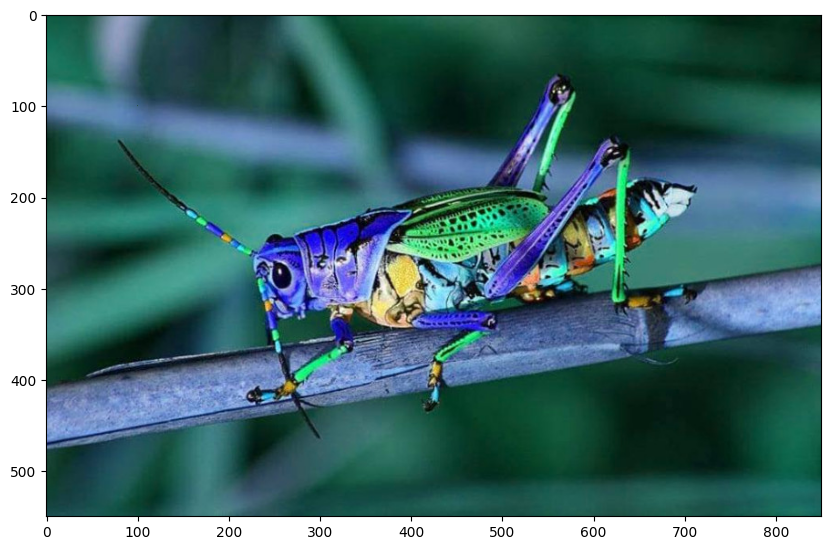

In [77]:
plt.imshow(input_image)

In [72]:
pixel = input_image[200,500]
print(pixel)

[32 77 44]


In [76]:
input_image[100,100] = [32,77,44]
pixelnew = input_image[100,100]
print(pixelnew)

[32 77 44]


## Obteniendo y modificando regiones de una imagen.

De la misma forma en que podemos acceder o modificar pixeles individuales, podemos obtener o modificar regiones de una imagen.

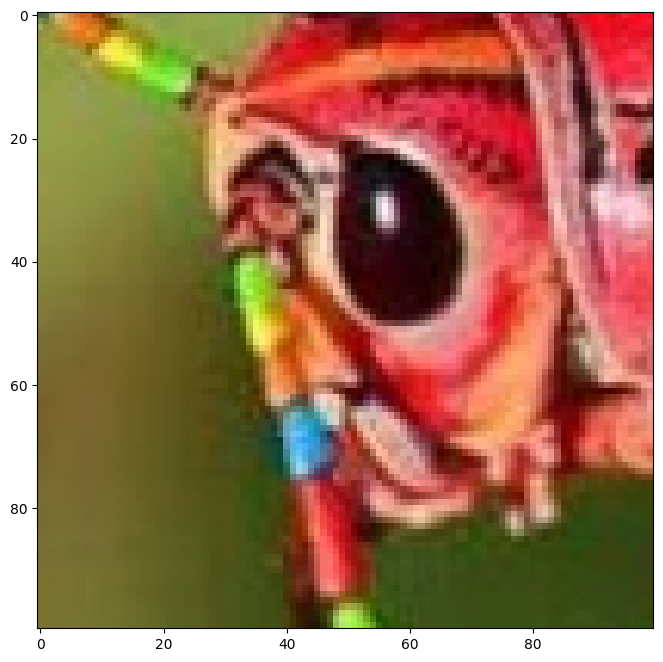

In [90]:
dogface = opencv_merged[250:350, 200:300]
plt.imshow(dogface)

In [82]:
dogface.shape

(200, 200, 3)

In [83]:
print(nombre)

johnwick.jpg


In [89]:
print(dogface[100][100])
print(dogface.shape[1])
print(dogface.shape[2])


[247 125 136]
200
3


100
100


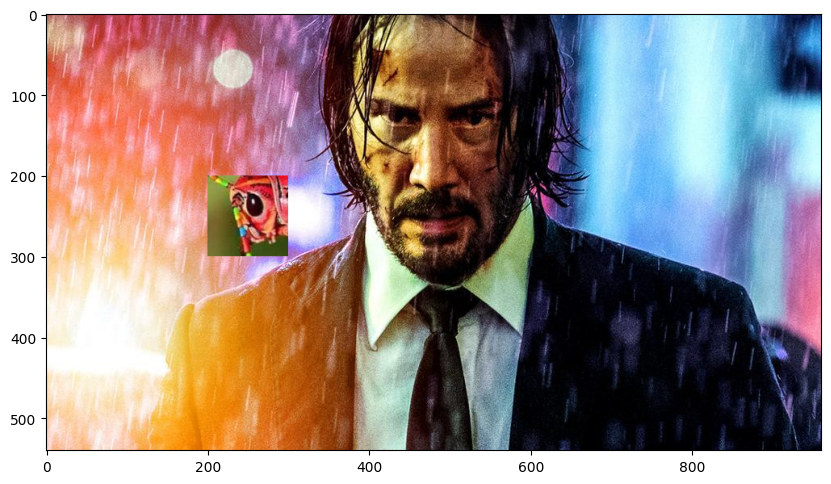

In [91]:
imagen_original=cv2.imread(nombre)
#fresh_image=cv2.imread(nombre) # iniciamos con una versión nueva de la imagen,
                                  # o podríamos terminar con imágenes anidadas
                                   # al ejecutar solo algunas partes del bloc de notas
fresh_image=cv2.cvtColor(imagen_original, cv2.COLOR_BGR2RGB) #Corregimos color

fresh_image[200:200+dogface.shape[0], 200:200+dogface.shape[1]]=dogface

print(dogface.shape[0])
print(dogface.shape[1])
plt.imshow(fresh_image)

## Rebanado de imágenes (matrices)
En OpenCV para python, ya hemos comentado que las imágenes son arreglos de numpy.

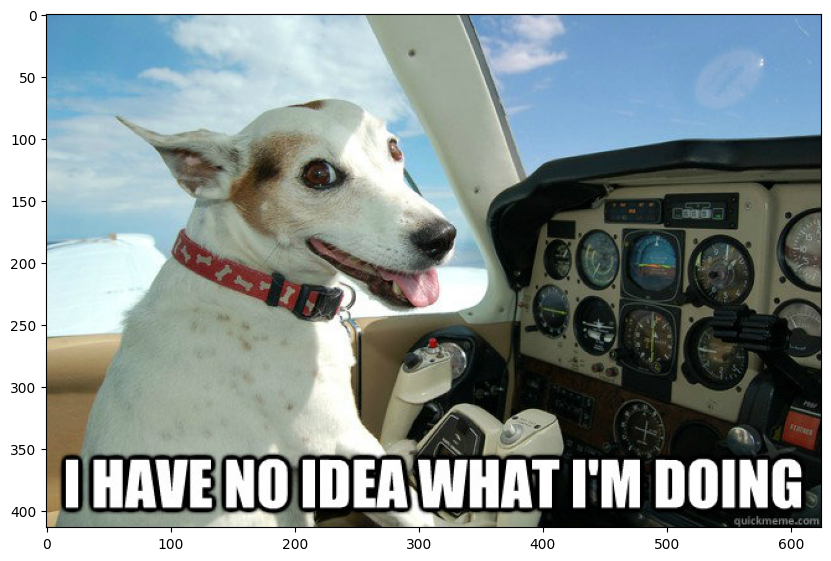

In [92]:
freshim1 = cv2.imread("noidea.jpg")
freshim2 =cv2.cvtColor(freshim1, cv2.COLOR_BGR2RGB) #Corregimos color
plt.imshow(freshim2)

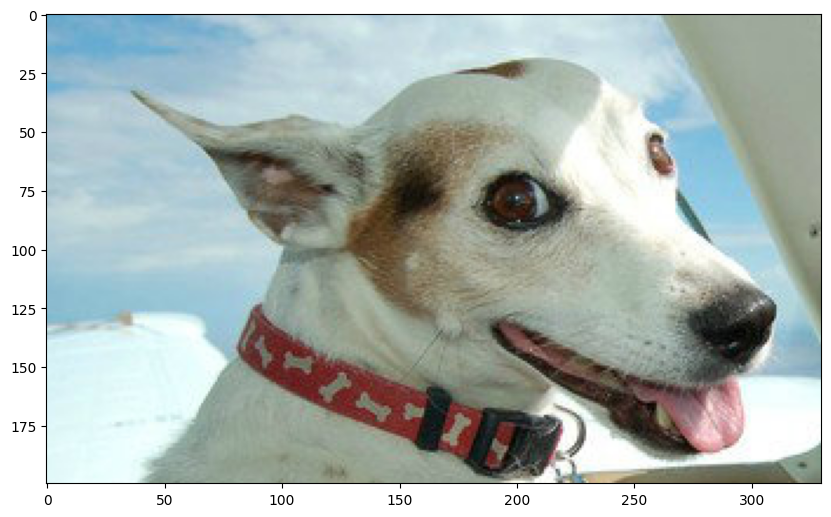

In [93]:
crop = freshim2[50:250, 20:350]
plt.imshow(crop)

La clave es darse cuenta que el rebanado funciona de la siguiente manera:
```
[top_y:bottom_y, left_x:right_x]
```
Esto puede verse también como:
```
[y:y+height, x:x+width]
```

Puedes incluso usar rebanado (slicing) para separar canales. En dicho caso lo que harías sería:
```
[y:y+height, x:x+width, channel]
```
donde channel representa el color en el que estás interesado - puede ser 0 = blue (azul), 1 = green (verde) o 2=red (rojo) si estás trabajando con la imagen por defecto de OpenCV, pero si tienes una imagen que ya has convertido pudiera ser algo diferente. El siguiente ejemplo convierte a HSV y selecciona el canal S (Saturation) de la rebanada realizada arriba:

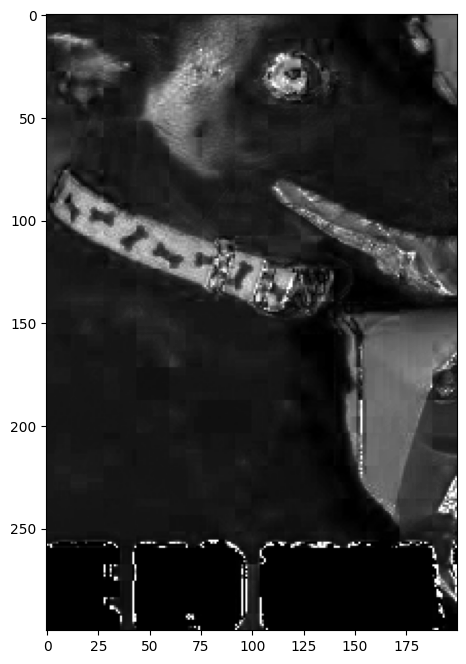

In [94]:
hsvim=cv2.cvtColor(freshim2,cv2.COLOR_BGR2HSV)
bcrop =hsvim[100:400, 100:300, 1]
plt.imshow(bcrop, cmap="gray")

## Estadísticas y procesamiento de imágenes

### Manipulaciones básicas (rotación, invertido, etc)

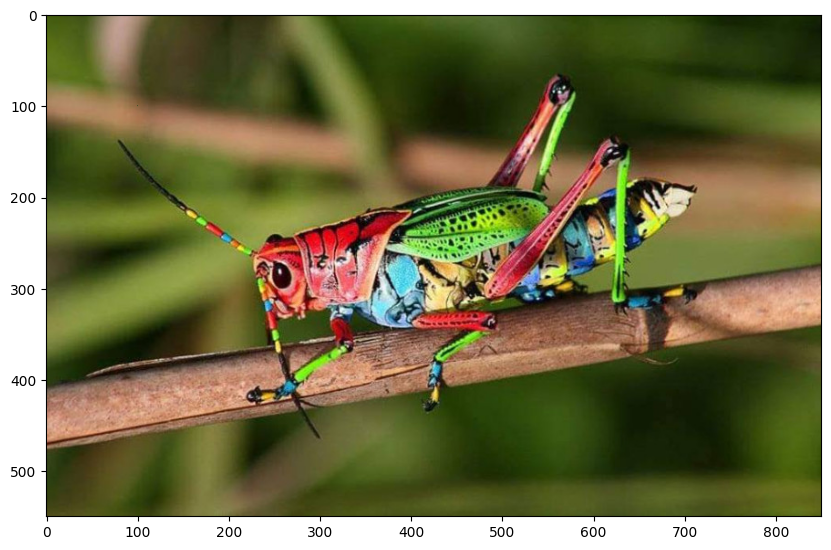

In [95]:
plt.imshow(opencv_merged)

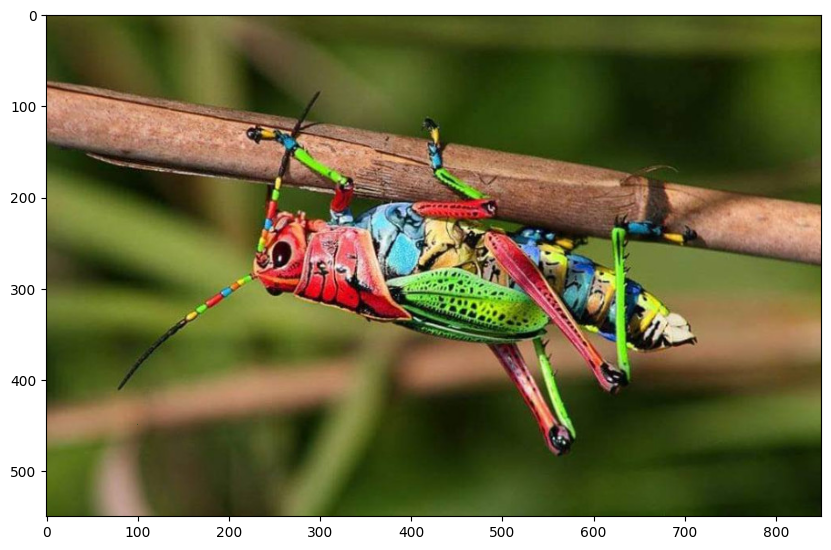

In [96]:
flipped_code_0=cv2.flip(opencv_merged,0) # vertical flip
plt.imshow(flipped_code_0)

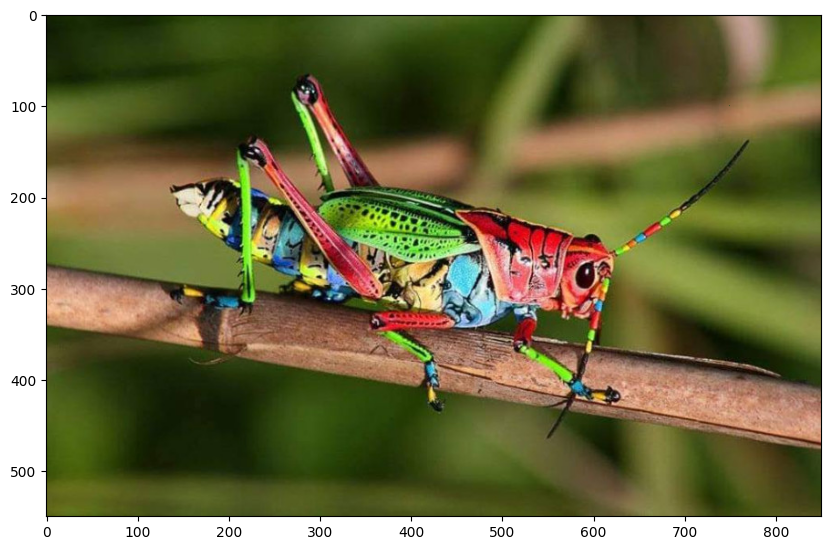

In [97]:
flipped_code_1=cv2.flip(opencv_merged,1) # horizontal flip
plt.imshow(flipped_code_1)

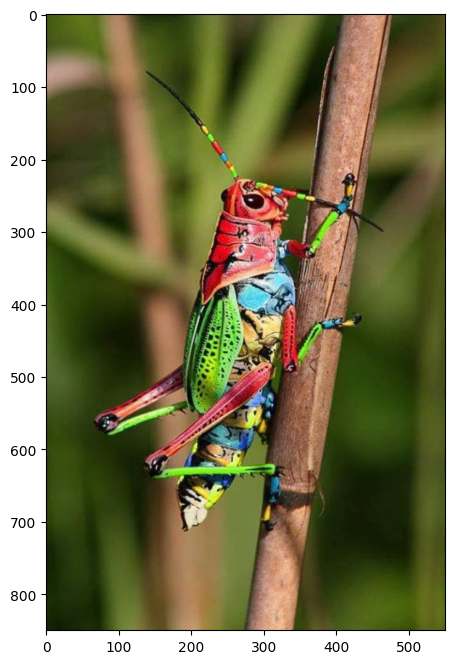

In [98]:
transposed=cv2.transpose(opencv_merged)
plt.imshow(transposed)

## Máximo y minimo

Para encontrar el máximo y mínimo de una matriz podemos usar minMaxLoc. Lo aplicaremos sobre un canal de la imagen a la vez. El siguiente código recorre cada canal (usando slicing) y obtiene los valores.

In [99]:
for i in range(0,3):
   min_value, max_value, min_location, max_location=cv2.minMaxLoc(input_image[:,:,i])
   print("min {} is at {}, and max {} is at {}".format(min_value, min_location, max_value, max_location))

min 0.0 is at (780, 0), and max 255.0 is at (563, 85)
min 0.0 is at (548, 85), and max 255.0 is at (568, 104)
min 0.0 is at (570, 77), and max 255.0 is at (550, 100)


In [101]:
input_image[85][548]

array([11,  0, 96], dtype=uint8)

## Operaciones aritméticas en imágenes

OpenCV tiene muchas funciones para realizar operaciones matemáticas sobre imagen y aunque numpy tienen algunas alternativas análogas es mejor utilizar OpenCV ya que está optimizado para trabajar con imágenes.

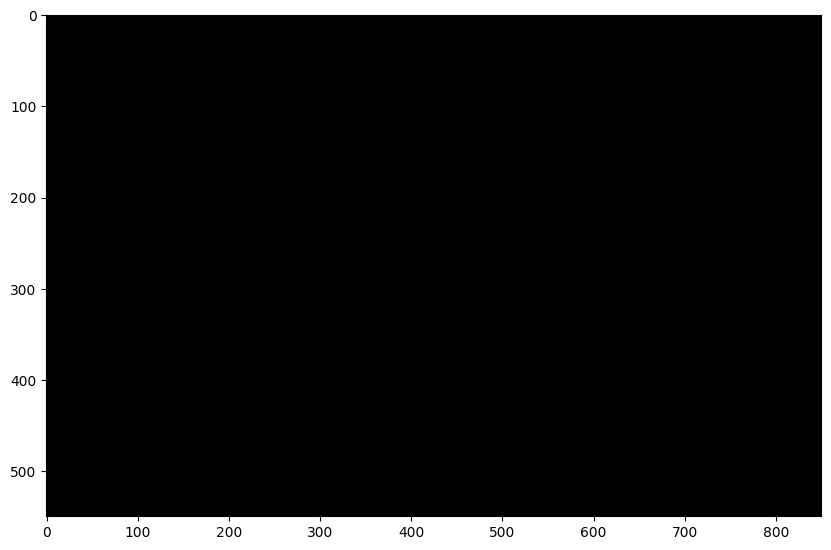

In [102]:
#Primero creamos una imagen del mismo tamaño que nuestra salida
blank_image = np.zeros((input_image.shape), np.uint8)

plt.imshow(cv2.cvtColor(blank_image, cv2.COLOR_BGR2RGB))

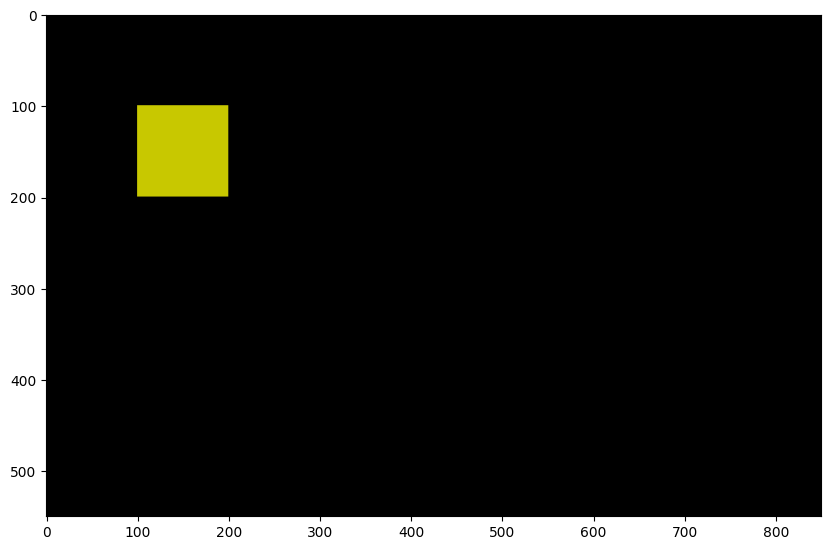

In [109]:
blank_image[100:200,100:200,2]=200; #Démosle un cuadro verde
blank_image[100:200,100:200,1]=200; #Démosle un cuadro verde

plt.imshow(cv2.cvtColor(blank_image, cv2.COLOR_BGR2RGB))

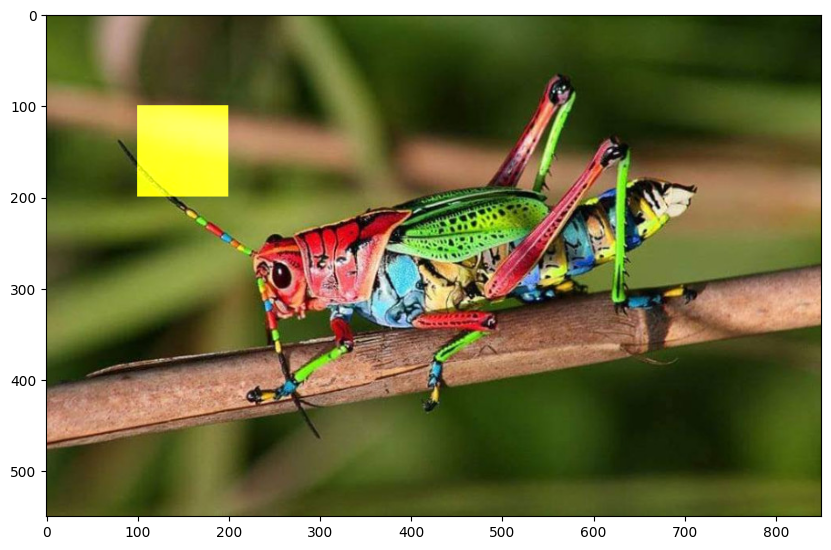

In [110]:
new_image=cv2.add(blank_image,input_image) # agreguemos las dos imágenes

plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))

## Reducción de ruido

La reducción de ruido implica suavizar o dar efecto borroso a una imagen usando un kernel (filtro) Gaussiano. El ancho del kernel determina la cantidad de suavizado.

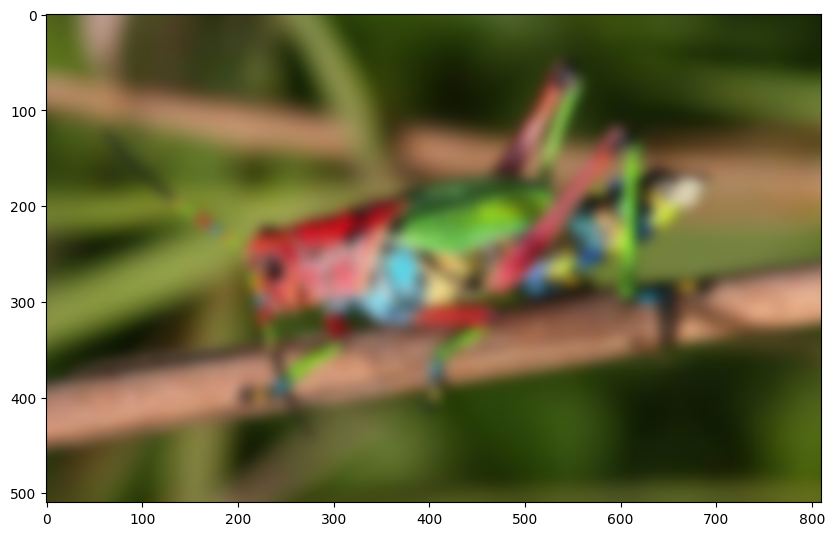

In [114]:
d=20
img_blur3 = cv2.GaussianBlur(input_image, (2*d+1, 2*d+1), -1)[d:-d,d:-d]

plt.imshow(cv2.cvtColor(img_blur3, cv2.COLOR_BGR2RGB))

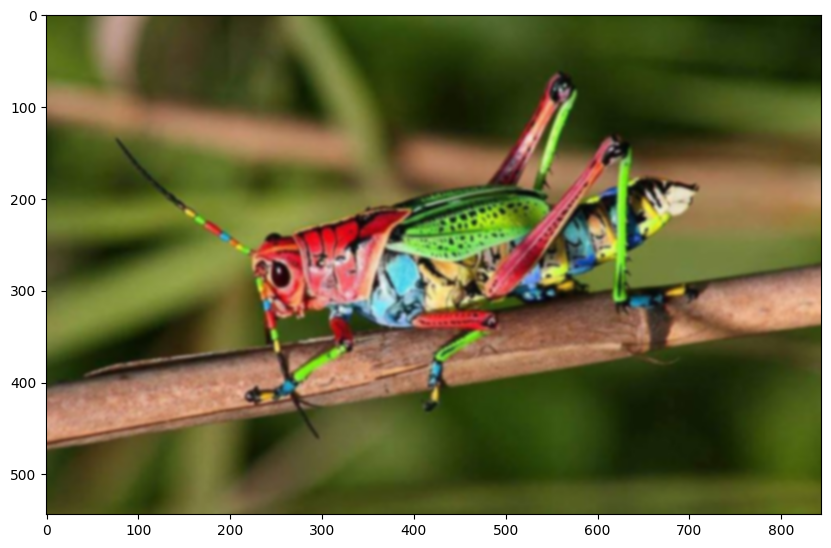

In [116]:
d=3
img_blur5 = cv2.GaussianBlur(input_image, (2*d+1, 2*d+1), -1)[d:-d,d:-d]

plt.imshow(cv2.cvtColor(img_blur5, cv2.COLOR_BGR2RGB))

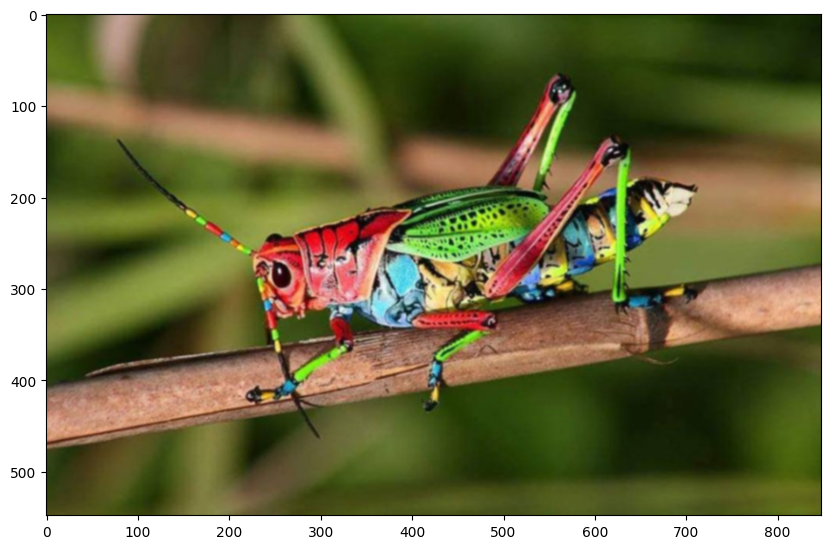

In [117]:
d=1
img_blur15 = cv2.GaussianBlur(input_image, (2*d+1, 2*d+1), -1)[d:-d,d:-d]

plt.imshow(cv2.cvtColor(img_blur15, cv2.COLOR_BGR2RGB))

## Bordes

### Sobel

La detección de bordes trabaja en su mayoría mediante convoluciones. El detector de bordes Sobel fue una de las primeras técnicas exitosas de detección de bordes e involucra convoluciones como su núcleo central.

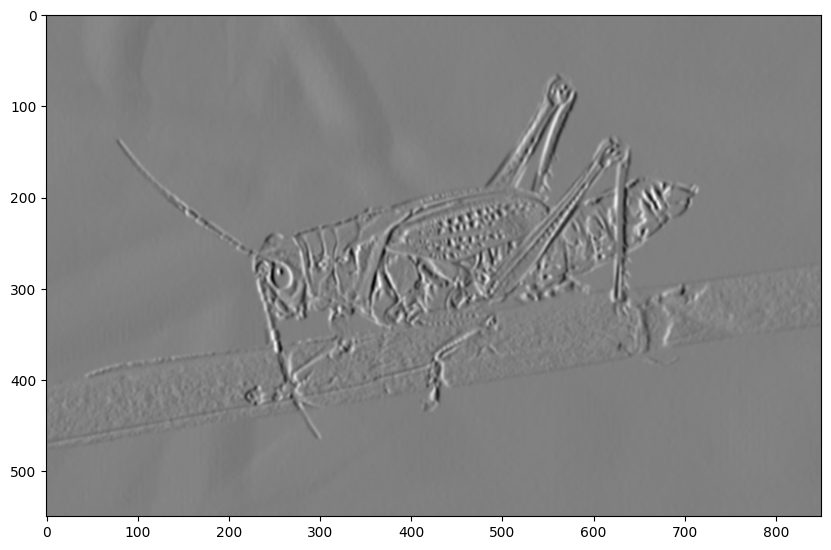

In [118]:
sobelimage=cv2.cvtColor(input_image,cv2.COLOR_BGR2GRAY)

sobelx = cv2.Sobel(sobelimage,cv2.CV_64F,1,0,ksize=9)
sobely = cv2.Sobel(sobelimage,cv2.CV_64F,0,1,ksize=9)
plt.imshow(sobelx,cmap = 'gray')
# Sobel trabaja en x y en y, cambia sobelx a sobely en la línea de arriba y observa la diferencia

### Canny
Detección de bordes Canny es otra de las técnicas más reconocidas. Utiliza dos umbrales. El primero determina que tan probable es que Canny encuentre un borde y el segundo determina que tan probable es seguir ese borde una vez que ha sido encontrado.

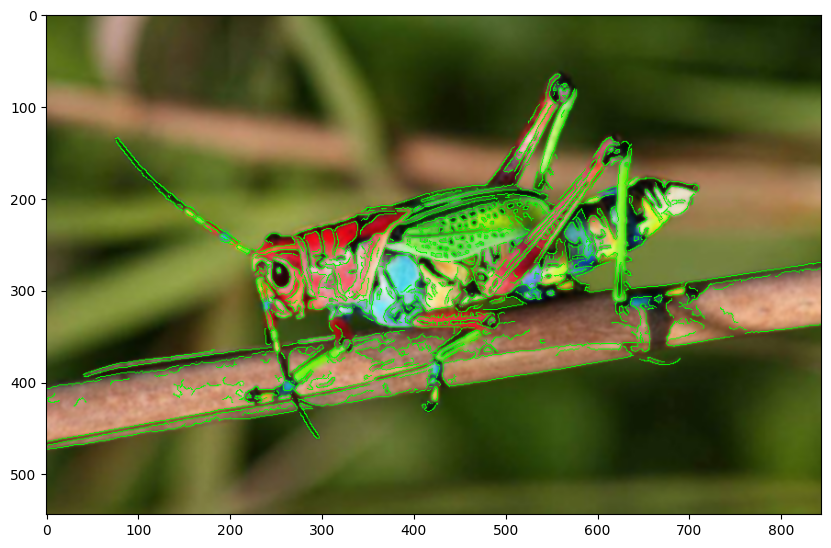

In [119]:
th1=30
th2=90 # Canny recomienda threshold 2 sea 3 veces threshold 1 - Experimenta por tu cuenta...
d=3 # gaussian blur

edgeresult=input_image.copy()
edgeresult = cv2.GaussianBlur(edgeresult, (2*d+1, 2*d+1), -1)[d:-d,d:-d]

gray = cv2.cvtColor(edgeresult, cv2.COLOR_BGR2GRAY)

edge = cv2.Canny(gray, th1, th2)

edgeresult[edge != 0] = (0, 255, 0) # toma los pixeles en edgeresult donde edge es difrente de cero y lo colorea de verde brillante

plt.imshow(cv2.cvtColor(edgeresult, cv2.COLOR_BGR2RGB))

# Clasificación utilizando Cascade

Una de las tareas principales de la Visión Computacional es la deteción de objetos.

La detección de objetos utilizando "Haar feature-based cascade classifiers" es un método efectivo de detección propuesto por Paul Viola y Michael Jones en su [artículo](https://www.cs.cmu.edu/~efros/courses/LBMV07/Papers/viola-cvpr-01.pdf) y mejorado posteriormente por [Rainer Leinhart](http://wiki.opencv.org.cn/images/5/52/MRL-TR-May02-revised-Dec02.pdf).

OpenCV proporciona modelos preentrenados, que pueden leerse utilizando el método: `cv2.CascadeClassifierload`. Estos modelos preentrenados se encuentran en la carpeta data de la instalación de OpenCV o pueden descargarse de [aquí](https://github.com/opencv/opencv/tree/3.4/data).

In [120]:
# Descargamos la imagen de prueba, los modelos preentrenados y utilerías.
!wget --no-check-certificate \
    https://media.wwdjapan.com/wp-content/uploads/2018/07/14124728/180702-03-1041.jpg \
    -O personas.jpg
!wget --no-check-certificate \
    https://www.noraemagazine.com/wp-content/uploads/2020/09/MAMAMOO2-1.png \
    -O personas2.jpg
!wget --no-check-certificate \
    https://upload.wikimedia.org/wikipedia/commons/e/e4/Blackpink_in_2020_for_PUBG_Mobile.png \
    -O personas3.jpg
!wget --no-check-certificate \
    https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/assets/test.jpg \
    -O personas4.jpg
!wget --no-check-certificate \
    https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/assets/haarcascade_frontalface_default.xml \
    -O haarcascade_frontalface_default.xml
!wget --no-check-certificate \
    https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/assets/haarcascade_smile.xml \
    -O haarcascade_smile.xml
!wget --no-check-certificate \
    https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/assets/haarcascade_eye.xml \
    -O haarcascade_eye.xml
!wget --no-check-certificate \
    https://raw.githubusercontent.com/computationalcore/introduction-to-opencv/master/utils/common.py \
    -O common.py

--2024-06-22 01:18:22--  https://media.wwdjapan.com/wp-content/uploads/2018/07/14124728/180702-03-1041.jpg
Resolving media.wwdjapan.com (media.wwdjapan.com)... 18.238.217.128, 18.238.217.65, 18.238.217.39, ...
Connecting to media.wwdjapan.com (media.wwdjapan.com)|18.238.217.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 964444 (942K) [image/jpeg]
Saving to: ‘personas.jpg’

personas.jpg        100%[===================>] 941.84K  1.59MB/s    in 0.6s    

2024-06-22 01:18:23 (1.59 MB/s) - ‘personas.jpg’ saved [964444/964444]

--2024-06-22 01:18:23--  https://www.noraemagazine.com/wp-content/uploads/2020/09/MAMAMOO2-1.png
Resolving www.noraemagazine.com (www.noraemagazine.com)... 104.21.50.129, 172.67.163.59, 2606:4700:3030::ac43:a33b, ...
Connecting to www.noraemagazine.com (www.noraemagazine.com)|104.21.50.129|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [image/png]
Saving to: ‘personas2.jpg’

personas2.jpg          

In [121]:
# Cargamos las bibliotecas necesarias
import cv2 #opencv itself
import common #some useful opencv functions
import numpy as np # matrix manipulations

#the following are to do with this interactive notebook code
%matplotlib inline
from matplotlib import pyplot as plt # this lets you draw inline pictures in the notebooks
import pylab # this allows you to control figure size
pylab.rcParams['figure.figsize'] = (10.0, 8.0) # this controls figure size in the notebook

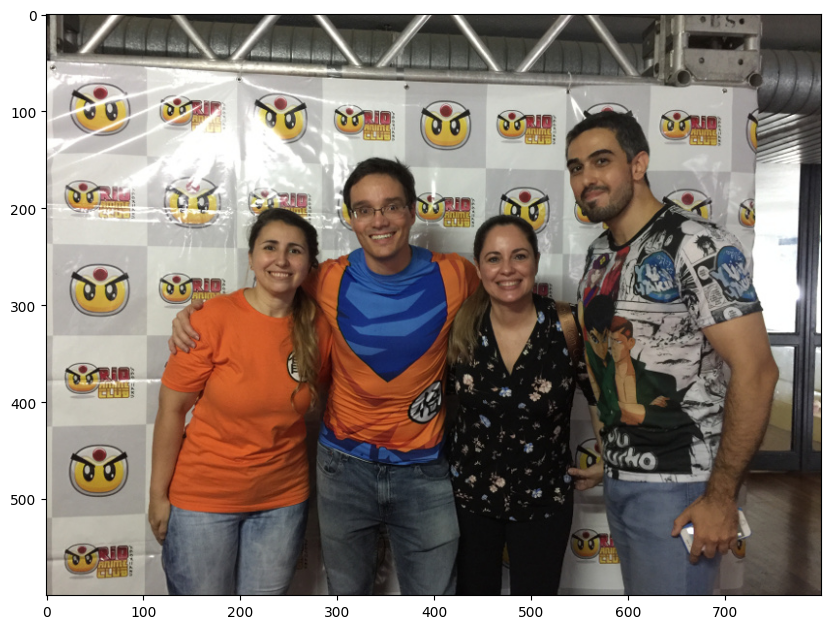

In [167]:
# Load the test image and create a greyscale copy of it to be used in the classifiers

base_image = cv2.imread('personas4.jpg')
grey = cv2.cvtColor(base_image, cv2.COLOR_BGR2GRAY)
plt.imshow(cv2.cvtColor(base_image, cv2.COLOR_BGR2RGB))

## Detección de rostros

Usaremos el modelo preentrenado haarcascade_frontalface_default.xml para detectar rostros en la foto.

Notarán que en los ejemplos se vuelve a cargar la imagen a color en cada ocasión, esto es debido a que la función imshow sobrescribe la imagen original con los recuadros pero usaremos siempre la misma imagen en escala de grises para la detección.

In [168]:
base_image = cv2.imread('personas4.jpg')
grey = cv2.cvtColor(base_image, cv2.COLOR_BGR2GRAY)

(4, 4)


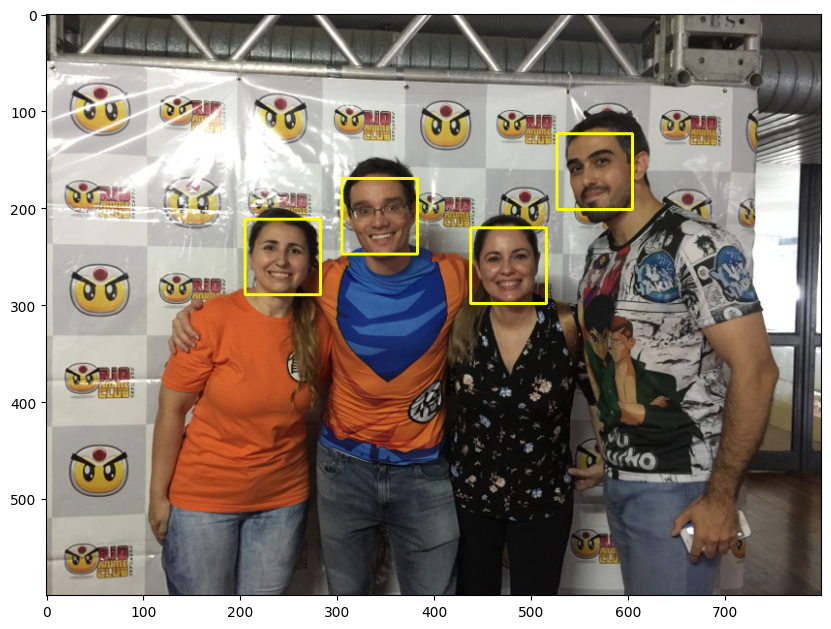

In [169]:
# Modelo preentrenado face cascade
test_image = cv2.imread('personas4.jpg')
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
faces = face_cascade.detectMultiScale(grey,1.8,3)
print(faces.shape)
for (x,y,w,h) in faces:
     cv2.rectangle(test_image,(x,y),(x+w,y+h),(0, 255, 255),2) #(152, 167, 232)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))

## Detección de sonrisas

Usaremos el modelo preentrenado haarcascade_smile.xml para detectar sonrisas en la imagen.

In [164]:
base_image = cv2.imread('personas4.jpg')
grey = cv2.cvtColor(base_image, cv2.COLOR_BGR2GRAY)

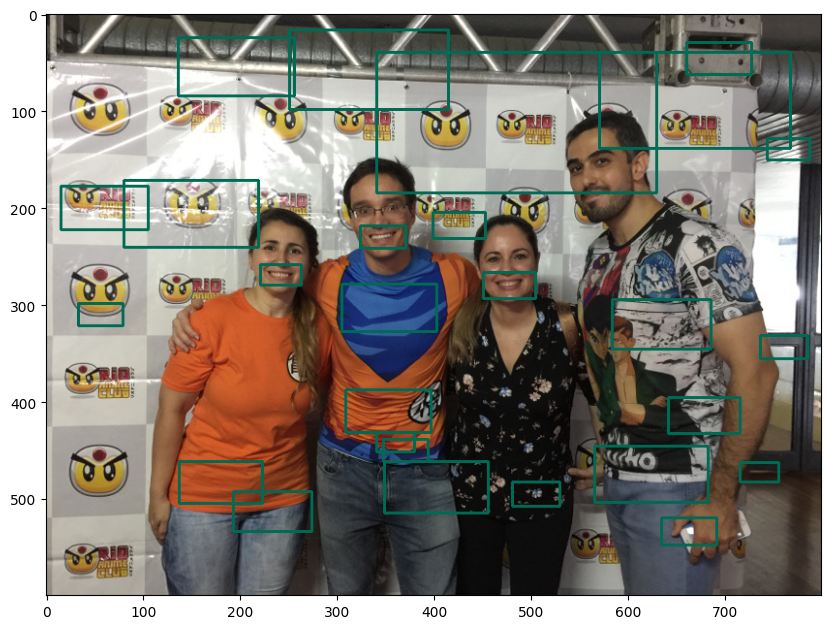

In [165]:
test_image = cv2.imread('personas4.jpg')
smile_cascade = cv2.CascadeClassifier('haarcascade_smile.xml')
smiles = smile_cascade.detectMultiScale(grey, 1.1, 20)
for (x,y,w,h) in smiles:
     cv2.rectangle(test_image,(x,y),(x+w,y+h),(84,107,0),2)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))

Como podemos observar, si detecta las sonrisas de las personas correctamente, pero con algunas imágenes puede haber falsos positivos, esto es normal en los modelos preentrenados cascade, para mejorar los resultados, buscaremos sonrisas en los rostros previamente detectados.

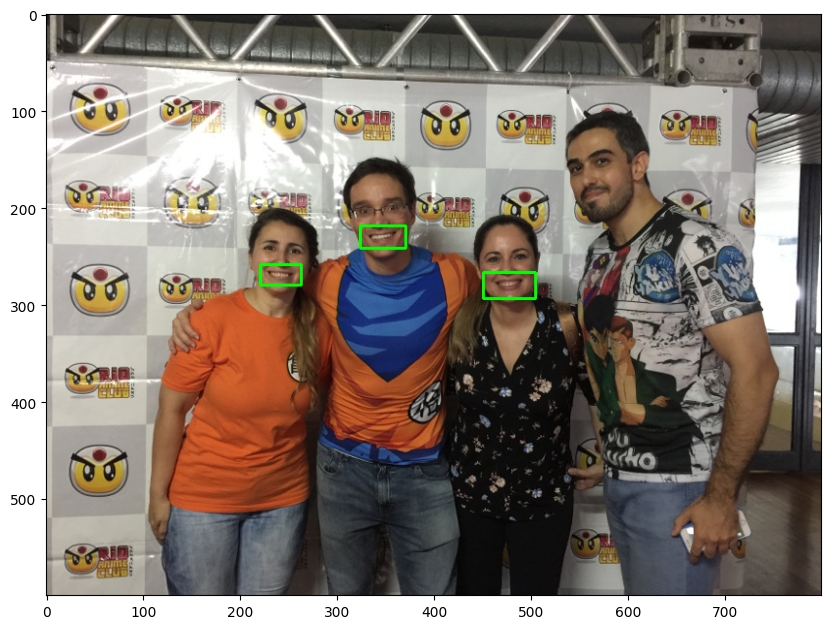

In [170]:
# this is a pre-trained face cascade
test_image = cv2.imread('personas4.jpg')
for (x,y,w,h) in faces:
  for (x_s,y_s,w_s,h_s) in smiles:
    if( (x <= x_s) and (y <= y_s) and ( x+w >= x_s+w_s) and ( y+h >= y_s+h_s)):
      cv2.rectangle(test_image, (x_s,y_s),(x_s+w_s,y_s+h_s),(0,255,0),2)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))

## Detección de ojos

Utilizaremos el modelo preentrenado haarcascade_eye.xml para detectar ojos en la imagen.

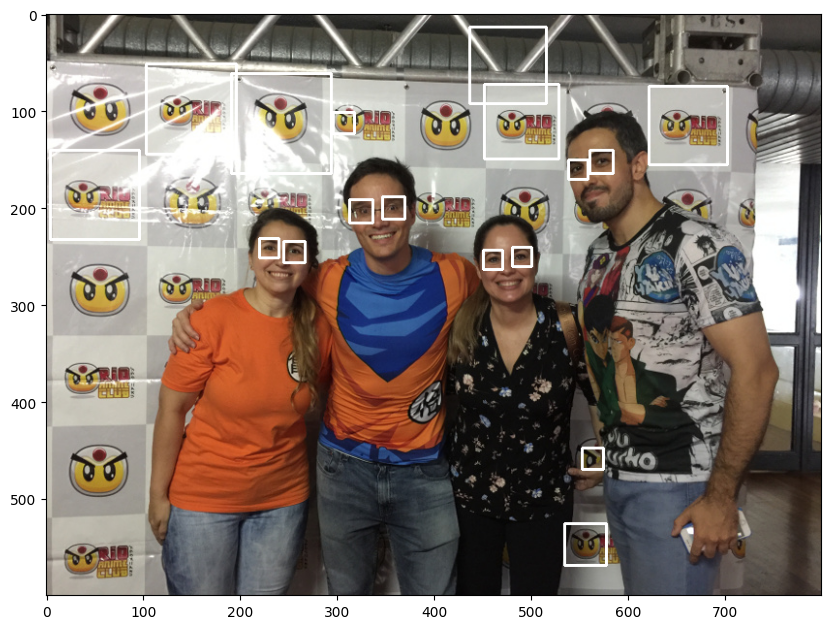

In [171]:
test_image = cv2.imread('personas4.jpg')
eye_cascade = cv2.CascadeClassifier('haarcascade_eye.xml')
eyes = eye_cascade.detectMultiScale(grey, 1.2, 1)
for (x,y,w,h) in eyes:
     cv2.rectangle(test_image,(x,y),(x+w,y+h),(255,255,255),2)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))

De igual forma que con las sonrisas pudiera ocurrir que ciertas imágenes arrojen falsos positivos por lo que podemos usar la misma técnica de solo buscar en los rostros detectados.

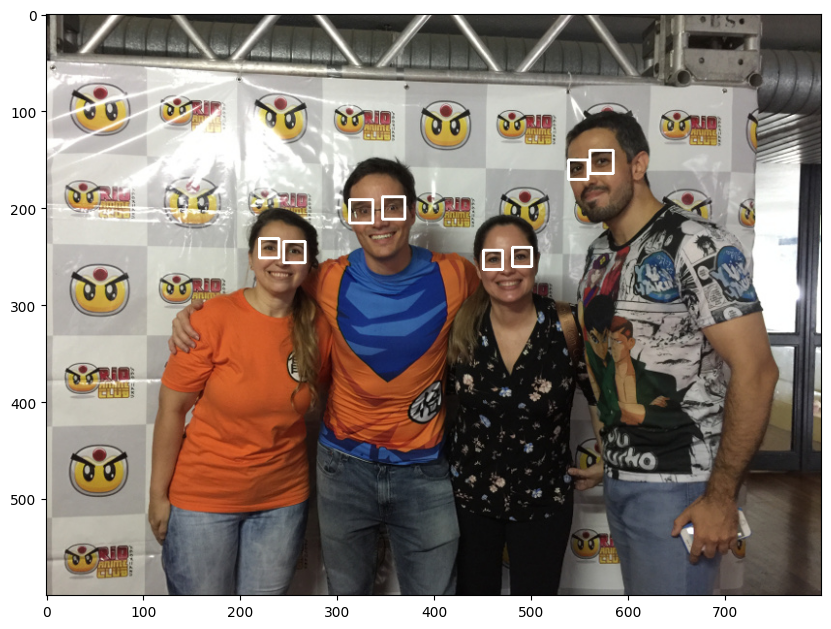

In [172]:
test_image = cv2.imread('personas4.jpg')
for (x,y,w,h) in faces:
  #cv2.rectangle(smile_faces_base_image,(x,y),(x+w,y+h),(255,0,0),2)
  for (x_s,y_s,w_s,h_s) in eyes:
    if( (x <= x_s) and (y <= y_s) and ( x+w >= x_s+w_s) and ( y+h >= y_s+h_s)):
      cv2.rectangle(test_image, (x_s,y_s),(x_s+w_s,y_s+h_s),(255,255,255),2)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))

## Hagamos ahora la detección de todo junto.

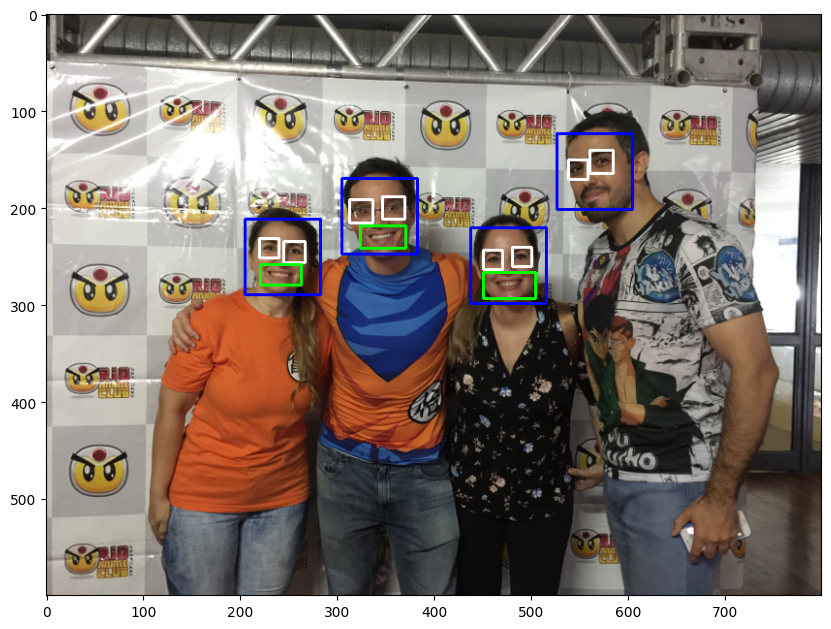

In [173]:
test_image = cv2.imread('personas4.jpg')
for (x,y,w,h) in faces:
  cv2.rectangle(test_image,(x,y),(x+w,y+h),(255,0,0),2)
  for (x_s,y_s,w_s,h_s) in eyes:
    if( (x <= x_s) and (y <= y_s) and ( x+w >= x_s+w_s) and ( y+h >= y_s+h_s)):
      cv2.rectangle(test_image, (x_s,y_s),(x_s+w_s,y_s+h_s),(255,255,255),2)
  for (x_s,y_s,w_s,h_s) in smiles:
    if( (x <= x_s) and (y <= y_s) and ( x+w >= x_s+w_s) and ( y+h >= y_s+h_s)):
      cv2.rectangle(test_image, (x_s,y_s),(x_s+w_s,y_s+h_s),(0,255,0),2)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))

Si bien es cierto que en la actualidad la mayor parte de la detección de objetos se realiza con modelos de redes neuronales profundas, el método de Viola Jones para la detección de rostros es todavia un detector bastante respetado y sin duda OpenCV sigue siendo muy utilizado aún en la actualidad.

## Referencias

1. Fundamentos de OpenCV recuperado de:
https://colab.research.google.com/github/computationalcore/introduction-to-opencv/blob/master/notebooks/1-Fundamentals.ipynb

2. Página oficial de OpenCV, https://opencv.org/.

